In [2]:
from flat import document, shape, rgba

from IPython.display import SVG, display
def show(page):
    display(SVG(page.svg()))
    
from bezmerizing import Polyline

import numpy as np
from numpy.random import uniform, normal, choice

from PIL import Image

In [3]:
from scipy.stats import truncnorm
def t_normal(a, b, mu, sigma):
    tn = truncnorm((a-mu)/sigma, (b-mu)/sigma, loc=mu, scale=sigma)
    return tn.rvs(1)[0]

This generative asemic writing system generates a character per grid and using pixel data of an image, the characteristic of the writing system gets adjusted with some random values also in place. I wanted to explore the concept of deriving writing from an image and create written text that describes the image but not in the conventional way of using works that describe the image itself.

The system generates individual characters to be able to color each polyline object differently. Each character width may run over to the space of the next character to create some overlap to create visual continuity, which is inspired by how characters in cursive writing often overlaps that of the next character. The color of the writing is generally in blue with differing levels of blue and opacity to give the look and feel of writing written using fountain pen. 

In [41]:
img = Image.open("gradient.png")
pixels = img.load()

In [42]:
d = document(200, 350, 'mm')
page = d.addpage()

col = 25
row = 28

ph = int(img.height / row)

for i in range(row):
    colnum = int(uniform(col - 4, col + 4))
    charsize = int(150 / colnum) + 2
    
    pw = int(img.width / colnum)
    for j in range(colnum):
        px = pixels[j * pw, i * ph]
        
        offset = int(px[0] / 255 * charsize) + 1
        if uniform(0, 1) > 0.2:
            fig = shape().nostroke().fill(rgba(0, 0, px[2], int(uniform(50, 100)) + int(px[2] / 255 * 50)))
            pts = []
            prange = int(t_normal(4, 24, 7 + int(px[1] / 255 * 10), int(px[1] / 255 * 5) + 1))
            for p in range(prange):
                pts.append([t_normal(charsize * j, charsize * (j + 1) + offset, charsize * j + offset, offset), uniform(12 * (i + 1) - 2, 12 * (i+ 2) - 2)])

            pline = Polyline(pts)
            lines = fig.polygon(pline.fancy_curve(samples_per=12, thicknesses=[0, 1, 2, 1, 0, 1]))
            page.place(lines)

show(page)

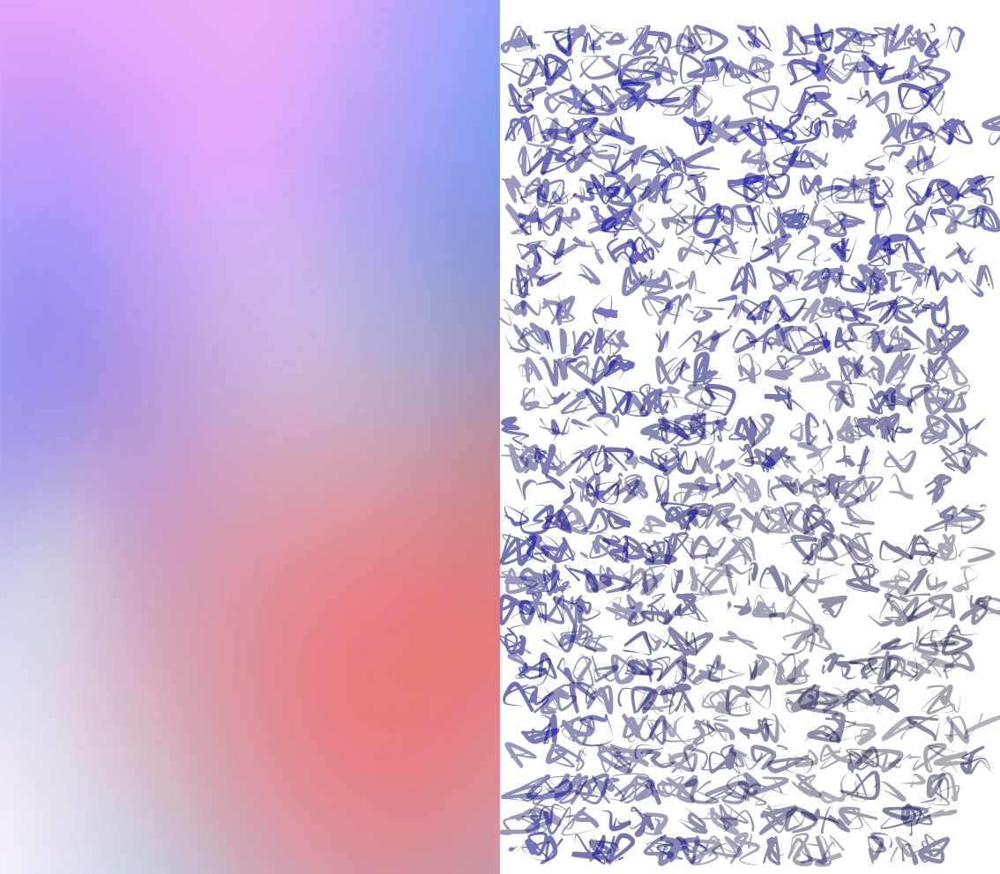

In [43]:
with open("gradient-writing.png", "wb") as fh:
    fh.write(page.image(ppi=72, kind="rgba").png())

newImg = Image.open("gradient-writing.png")

Image.fromarray(np.hstack((np.array(img),np.array(newImg))))

In [44]:
import json
chars = json.load(open("char74k-normalized.json"))

from random import choice
from itertools import chain

all_forms = list(chain(*chars.values()))
all_strokes = list(chain(*all_forms))

def make_halfsies():
    left = choice(all_forms)
    right = choice(all_forms)
    left_strokes = []
    right_strokes = []
    for stroke in left:
        pts = []
        for pt in stroke:
            if pt[0] < 0:
                pts.append(pt)
        if len(pts) > 1:
            left_strokes.append(Polyline(pts))
    for stroke in right:
        pts = []
        for pt in stroke:
            if pt[0] > 0:
                pts.append(pt)
        if len(pts) > 1:
            right_strokes.append(Polyline(pts))
    return left_strokes + right_strokes

d = document(200, 350, 'mm')
page = d.addpage()

col = 25
row = 28

ph = int(img.height / row)

for i in range(row):
    colnum = int(uniform(col - 4, col + 4))
    charsize = int(150 / colnum) + 2
    
    pw = int(img.width / colnum)
    for j in range(colnum):
        
        x = i * pw + (pw * 0.5) # add 1/2 cell size to offset glyph center
        y = j * ph + (ph * 0.5)
        
        px = pixels[j * pw, i * ph]
        
        offset = int(px[0] / 255 * charsize) + 1
        if uniform(0, 1) > 0.2:
            fig = shape().nostroke().fill(rgba(0, 0, px[2], int(uniform(50, 100)) + int(px[2] / 255 * 50)))
            pts = []
            
            glyph = make_halfsies()
            for pline in glyph:
                pline = pline.augment().scale(px[1] / 255 * 0.1).translate(t_normal(charsize * j, charsize * (j + 1) + offset, charsize * j + offset, offset), uniform(12 * (i + 1) - 2, 12 * (i+ 2) - 2))
                curve = pline.fancy_curve(samples_per=12, thicknesses=[0, 1, 2, 1, 3, 1])
                page.place(fig.polygon(curve))
                pline = pline.rotate(uniform(2*np.pi)).scale(px[1] / 255 * 0.1).translate(t_normal(charsize * j, charsize * (j + 1) + offset, charsize * j + offset, offset), uniform(12 * (i + 1) - 2, 12 * (i+ 2) - 2))
                page.place(fig.polyline(pline))

show(page)

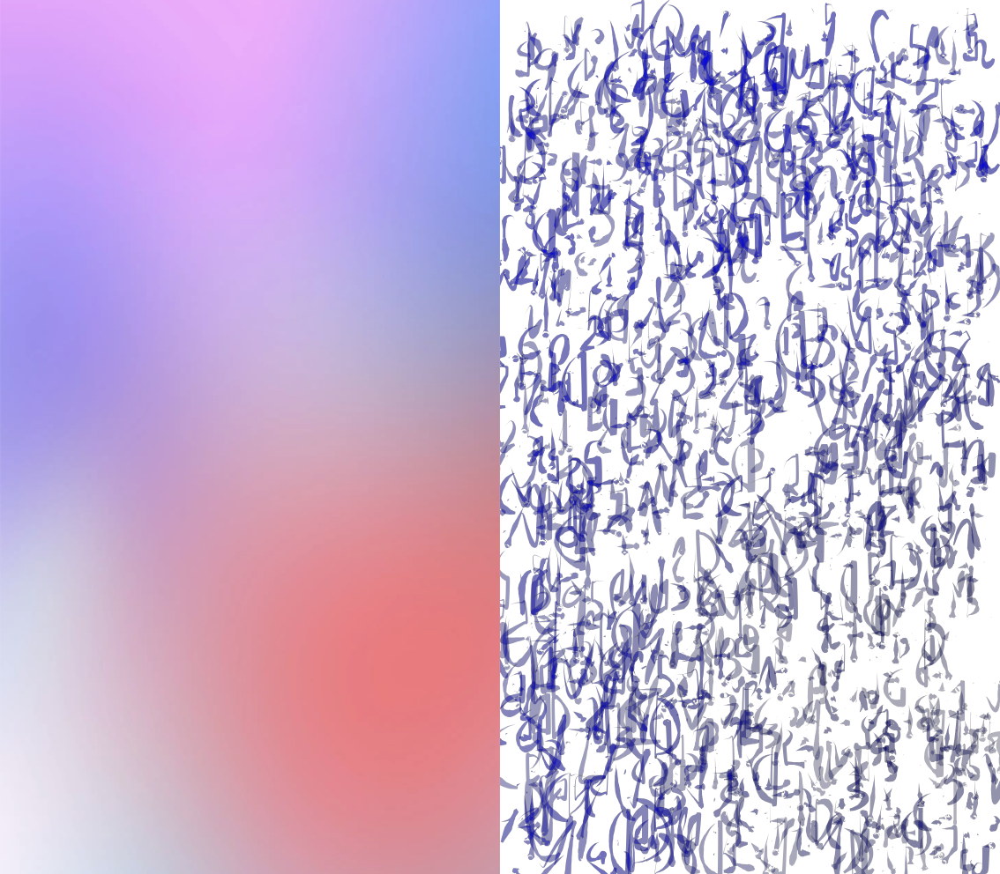

In [45]:
with open("gradient-writing-hand.png", "wb") as fh:
    fh.write(page.image(ppi=72, kind="rgba").png())

newImg = Image.open("gradient-writing-hand.png")

Image.fromarray(np.hstack((np.array(img),np.array(newImg))))

In [46]:
img = Image.open("forest.png")
pixels = img.load()

In [47]:
d = document(200, 350, 'mm')
page = d.addpage()

col = 25
row = 28

ph = int(img.height / row)

for i in range(row):
    colnum = int(uniform(col - 4, col + 4))
    charsize = int(150 / colnum) + 2
    
    pw = int(img.width / colnum)
    for j in range(colnum):
        px = pixels[j * pw, i * ph]
        
        offset = int(px[0] / 255 * charsize) + 1
        if uniform(0, 1) > 0.2:
            fig = shape().nostroke().fill(rgba(0, 0, px[2], int(uniform(50, 100)) + int(px[2] / 255 * 50)))
            pts = []
            prange = int(t_normal(4, 24, 7 + int(px[1] / 255 * 10), int(px[1] / 255 * 5) + 1))
            for p in range(prange):
                pts.append([t_normal(charsize * j, charsize * (j + 1) + offset, charsize * j + offset, offset), uniform(12 * (i + 1) - 2, 12 * (i+ 2) - 2)])

            pline = Polyline(pts)
            lines = fig.polygon(pline.fancy_curve(samples_per=12, thicknesses=[0, 1, 2, 1, 0, 1]))
            page.place(lines)

show(page)

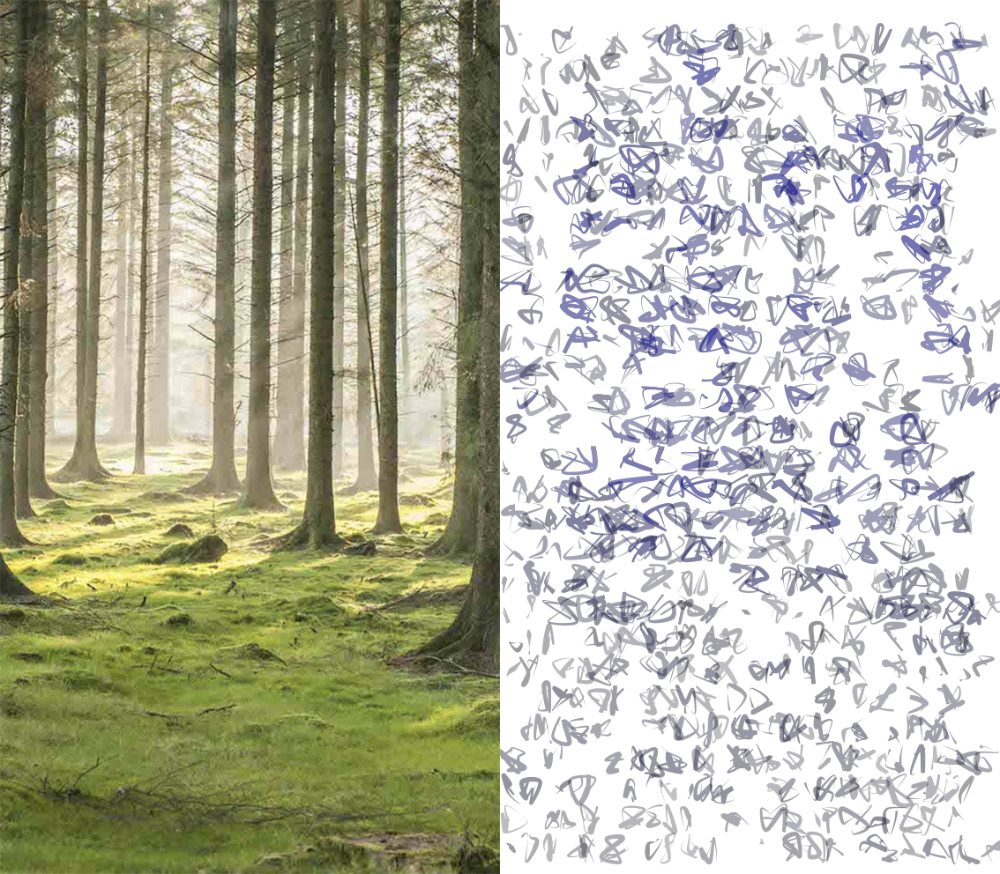

In [48]:
with open("forest-writing.png", "wb") as fh:
    fh.write(page.image(ppi=72, kind="rgba").png())

newImg = Image.open("forest-writing.png")

Image.fromarray(np.hstack((np.array(img),np.array(newImg))))

In [49]:
d = document(200, 350, 'mm')
page = d.addpage()

col = 25
row = 28

ph = int(img.height / row)

for i in range(row):
    colnum = int(uniform(col - 4, col + 4))
    charsize = int(150 / colnum) + 2
    
    pw = int(img.width / colnum)
    for j in range(colnum):
        
        x = i * pw + (pw * 0.5) # add 1/2 cell size to offset glyph center
        y = j * ph + (ph * 0.5)
        
        px = pixels[j * pw, i * ph]
        
        offset = int(px[0] / 255 * charsize) + 1
        if uniform(0, 1) > 0.2:
            fig = shape().nostroke().fill(rgba(0, 0, px[2], int(uniform(50, 100)) + int(px[2] / 255 * 50)))
            pts = []
            
            glyph = make_halfsies()
            for pline in glyph:
                pline = pline.augment().scale(px[1] / 255 * 0.1).translate(t_normal(charsize * j, charsize * (j + 1) + offset, charsize * j + offset, offset), uniform(12 * (i + 1) - 2, 12 * (i+ 2) - 2))
                curve = pline.fancy_curve(samples_per=12, thicknesses=[0, 1, 2, 1, 3, 1])
                page.place(fig.polygon(curve))
                pline = pline.rotate(uniform(2*np.pi)).scale(px[1] / 255 * 0.1).translate(t_normal(charsize * j, charsize * (j + 1) + offset, charsize * j + offset, offset), uniform(12 * (i + 1) - 2, 12 * (i+ 2) - 2))
                page.place(fig.polyline(pline))

show(page)

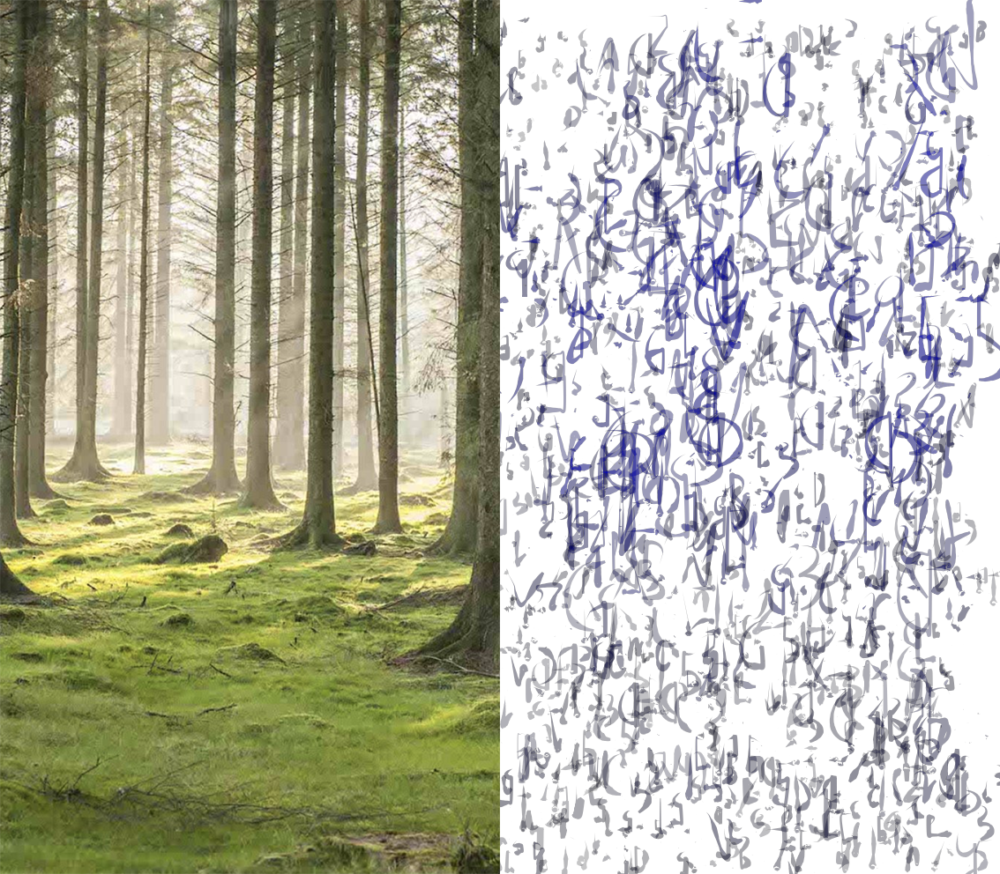

In [50]:
with open("forest-writing-hand.png", "wb") as fh:
    fh.write(page.image(ppi=72, kind="rgba").png())

newImg = Image.open("forest-writing-hand.png")

Image.fromarray(np.hstack((np.array(img),np.array(newImg))))

In [51]:
img = Image.open("sunset.png")
pixels = img.load()

In [52]:
d = document(200, 350, 'mm')
page = d.addpage()

col = 25
row = 28

ph = int(img.height / row)

for i in range(row):
    colnum = int(uniform(col - 4, col + 4))
    charsize = int(150 / colnum) + 2
    
    pw = int(img.width / colnum)
    for j in range(colnum):
        px = pixels[j * pw, i * ph]
        
        offset = int(px[0] / 255 * charsize) + 1
        if uniform(0, 1) > 0.2:
            fig = shape().nostroke().fill(rgba(0, 0, px[2], int(uniform(50, 100)) + int(px[2] / 255 * 50)))
            pts = []
            prange = int(t_normal(4, 24, 7 + int(px[1] / 255 * 10), int(px[1] / 255 * 5) + 1))
            for p in range(prange):
                pts.append([t_normal(charsize * j, charsize * (j + 1) + offset, charsize * j + offset, offset), uniform(12 * (i + 1) - 2, 12 * (i+ 2) - 2)])

            pline = Polyline(pts)
            lines = fig.polygon(pline.fancy_curve(samples_per=12, thicknesses=[0, 1, 2, 1, 0, 1]))
            page.place(lines)

show(page)

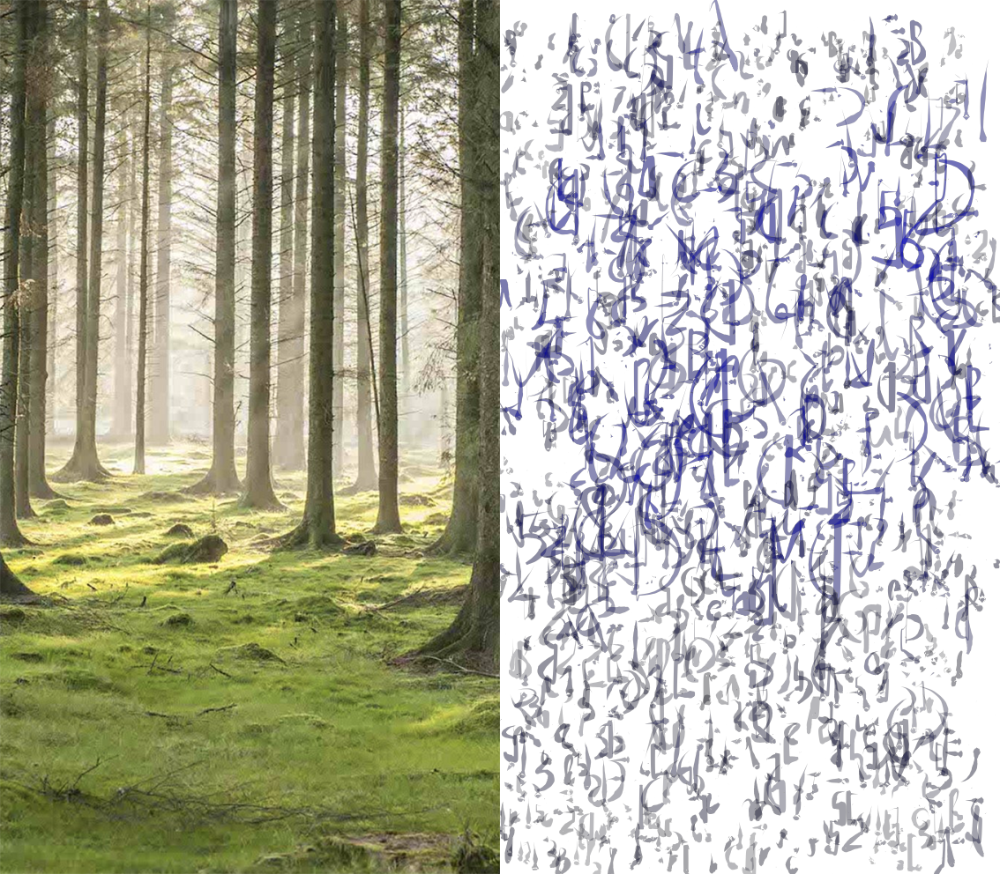

In [39]:
with open("sunset-writing.png", "wb") as fh:
    fh.write(page.image(ppi=72, kind="rgba").png())

newImg = Image.open("sunset-writing.png")

Image.fromarray(np.hstack((np.array(img),np.array(newImg))))

In [ ]:
d = document(200, 350, 'mm')
page = d.addpage()

col = 25
row = 28

ph = int(img.height / row)

for i in range(row):
    colnum = int(uniform(col - 4, col + 4))
    charsize = int(150 / colnum) + 2
    
    pw = int(img.width / colnum)
    for j in range(colnum):
        
        x = i * pw + (pw * 0.5) # add 1/2 cell size to offset glyph center
        y = j * ph + (ph * 0.5)
        
        px = pixels[j * pw, i * ph]
        
        offset = int(px[0] / 255 * charsize) + 1
        if uniform(0, 1) > 0.2:
            fig = shape().nostroke().fill(rgba(0, 0, px[2], int(uniform(50, 100)) + int(px[2] / 255 * 50)))
            pts = []
            
            glyph = make_halfsies()
            for pline in glyph:
                pline = pline.augment().scale(px[1] / 255 * 0.1).translate(t_normal(charsize * j, charsize * (j + 1) + offset, charsize * j + offset, offset), uniform(12 * (i + 1) - 2, 12 * (i+ 2) - 2))
                curve = pline.fancy_curve(samples_per=12, thicknesses=[0, 1, 2, 1, 3, 1])
                page.place(fig.polygon(curve))
                pline = pline.rotate(uniform(2*np.pi)).scale(px[1] / 255 * 0.1).translate(t_normal(charsize * j, charsize * (j + 1) + offset, charsize * j + offset, offset), uniform(12 * (i + 1) - 2, 12 * (i+ 2) - 2))
                page.place(fig.polyline(pline))

show(page)

In [ ]:
with open("sunset-writing-hand.png", "wb") as fh:
    fh.write(page.image(ppi=72, kind="rgba").png())

newImg = Image.open("sunset-writing-hand.png")

Image.fromarray(np.hstack((np.array(img),np.array(newImg))))